In [36]:
from cryoS2Sdrop.analyze import *
from cryoS2Sdrop.deconvolution import tom_deconv_tomo

PARENT_PATH = setup.PARENT_PATH

pd.options.display.float_format = "{:,.6f}".format
pd.set_option('display.max_columns', 50)

%matplotlib inline
%config Completer.use_jedi = False
%load_ext autoreload
%autoreload 2

def plot_centralSlices(tomo_data, set_axis_off, names=None):
    shape = np.array(tomo_data.shape)
    idx_central_slices = shape//2
    ratios = shape/shape.max()
    
    fig, ax = plt.subplots(1, 3, figsize=(25, 10), gridspec_kw={'width_ratios': ratios})  
    if set_axis_off:
        list(map(lambda axi: axi.set_axis_off(), ax.ravel()))
        
    plt.tight_layout()
    
    if names is None:
        names = ['Central XY plane', 'Central ZX plane', 'Central ZY plane']
    
    for i in range(3):
        tomo_slice = np.take(tomo_data, idx_central_slices[i], axis=i)
        ax[i].imshow(tomo_slice)
        ax[i].set_title(names[i], fontsize=16)
    
    plt.show()
    
    return fig, ax

def make_shell(inner_radius, outer_radius, tomo_shape):
    """
    Creates a (3D) shell with given inner_radius and delta_r width centered at the middle of the array.

    """

    length = min(tomo_shape)
    if length % 2 == 1:
        length = length - 1

    mask_shape = len(tomo_shape) * [length]
    _shell_mask = np.zeros(mask_shape)

    # only do positive quadrant first
    for z in range(0, outer_radius + 1):
        for y in range(0, outer_radius + 1):
            for x in range(0, outer_radius + 1):

                r = np.linalg.norm([z, y, x])

                if r >= inner_radius and r < outer_radius:
                    zidx = z + length // 2
                    yidx = y + length // 2
                    xidx = x + length // 2

                    _shell_mask[zidx, yidx, xidx] = 1

    aux = (
        np.rot90(_shell_mask, axes=(0, 1))
        + np.rot90(_shell_mask, 2, axes=(0, 1))
        + np.rot90(_shell_mask, 3, axes=(0, 1))
    )

    _shell_mask = _shell_mask + aux  # this is half the volume

    aux = np.rot90(
        _shell_mask, 2, axes=(1, 2)
    )  # rotate again 180º to get full volume

    aux2 = _shell_mask + aux

    if inner_radius == 0:
        vol = 4 / 3 * np.pi * outer_radius**3
        pct_diff = (vol - aux2.sum()) / vol
        if pct_diff > 0.1:
            print(pct_diff)
            raise ValueError("Sanity check for sphere volume not passed")

    # finally, fill the actual shape of the tomogram with the mask
    shell_mask = np.zeros(tomo_shape)
    shell_mask[
        (tomo_shape[0] - length) // 2 : (tomo_shape[0] + length) // 2,
        (tomo_shape[1] - length) // 2 : (tomo_shape[1] + length) // 2,
        (tomo_shape[2] - length) // 2 : (tomo_shape[2] + length) // 2,
    ] = aux2

    return shell_mask

def create_hiFreqMask(tomo_shape, fourier_tomo_shape):
    "Randomly mask high frequencies with a sphere"
    inner = 0
    shape_vol = np.array(tomo_shape).prod()
    low_r = (0.05 * 3/(4*np.pi) * shape_vol)**(1/3)
    high_r = (0.1 * 3/(4*np.pi) * shape_vol)**(1/3)
    outer = np.random.uniform(low_r, high_r)
    outer = int(np.round(outer))
    
    shell_mask = make_shell(inner, outer, tomo_shape)
    # up to this point we have a shell for the shifted (centered) full spectrum
    shell_mask = torch.tensor(shell_mask)
    # # make shell correspond to the unshifted spectrum
    # shell_mask = torch.fft.ifftshift(shell_mask)
    # # make it correspond to only real part of spectrum
    # shell_mask = shell_mask[..., 0 : fourier_tomo_shape[-1]]

    return shell_mask.float().numpy()

def create_Vmask(tomo_shape, volumetric_scale_factor):
    "Create volumetric blind spot random mask"
    downsampled_shape = np.array(tomo_shape) // volumetric_scale_factor
    downsampled_shape = tuple(downsampled_shape)

    bernoulli_Vmask = dropoutV(torch.ones(downsampled_shape)) * (
        1 - dropoutV.p
    )
    bernoulli_Vmask = bernoulli_Vmask.unsqueeze(0).unsqueeze(0)
    bernoulli_Vmask = upsample(bernoulli_Vmask)
    
    # adjust for uneven sizes on dimension 0
    diff0 = tomo_shape[0] - bernoulli_Vmask.shape[2]
    if (diff0 > 0) and (diff0 < volumetric_scale_factor):
        extra_row = bernoulli_Vmask[:, :, 0:diff0, ...]
        bernoulli_Vmask = torch.cat([extra_row, bernoulli_Vmask], dim=2)

    return bernoulli_Vmask.squeeze().numpy()

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Load data

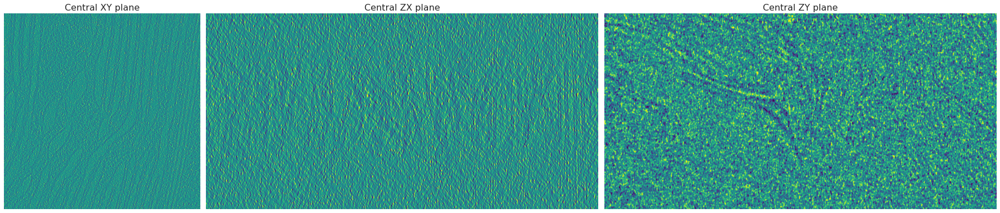

In [68]:
# tomo_name = "tomoPhantom_model14_noisyGaussPoissL"
# tomo_name = "shrec2021_model4_dummy"
tomo_name = "tomo02_dummy"

cet_path, gt_cet_path = parse_tomoPaths(tomo_name)
tomo_data, gt_tomo_data = read_array(cet_path), read_array(gt_cet_path)

tomo_data = standardize(clip(tomo_data))
gt_tomo_data = standardize(clip(gt_tomo_data))

fourier_tomo = np.fft.fftshift(np.fft.fftn(tomo_data))
fourier_tomo_shape = np.array(fourier_tomo.shape)

tomo_shape = np.array(tomo_data.shape)
fig, ax = plot_centralSlices(tomo_data, set_axis_off=True)

# Q1: High Frequency radius

I want to set a proper cutoff frequency for the low pass filter that allows to still have similar images, but with slight variations.

Looks like using a sphere that covers between 5 and 10% of the total volume is a good idea.

In [4]:
# looks like 5% looks reasonable
shape_vol = tomo_shape.prod()
cover_ratio = 0.05
r = (cover_ratio * 3/(4*np.pi) * shape_vol)**(1/3)
r

84.16569494346916

Percentage of the volume covered by the sphere 0.00 at radius 5


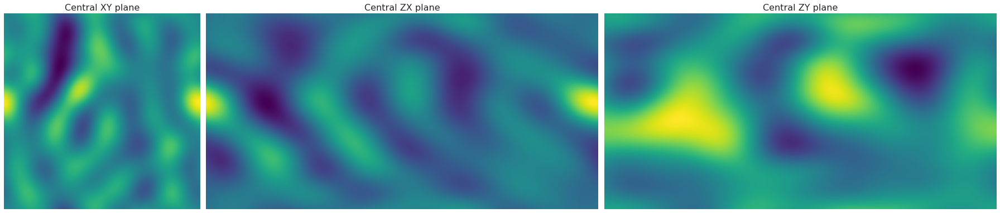

Percentage of the volume covered by the sphere 0.13 at radius 25


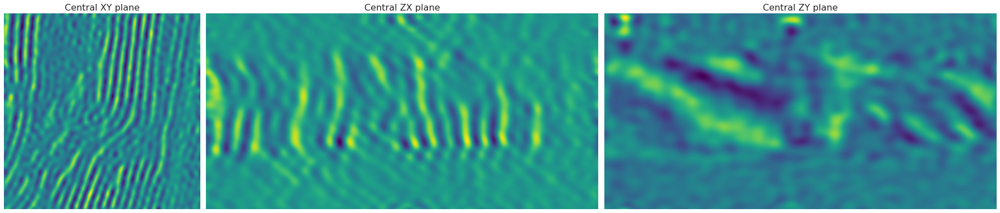

Percentage of the volume covered by the sphere 0.76 at radius 45


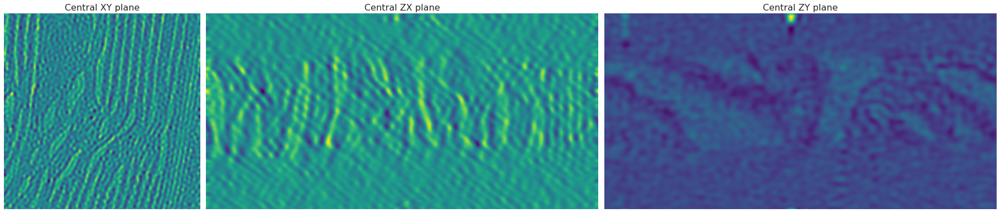

Percentage of the volume covered by the sphere 2.30 at radius 65


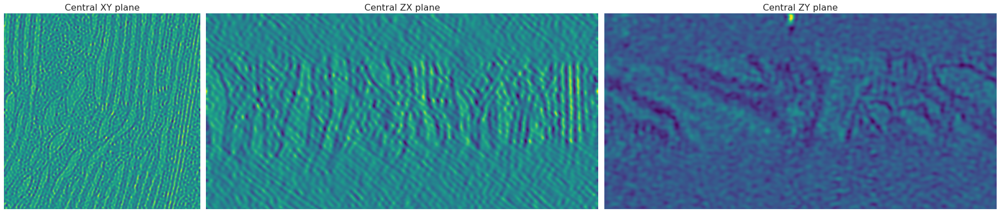

Percentage of the volume covered by the sphere 5.15 at radius 85


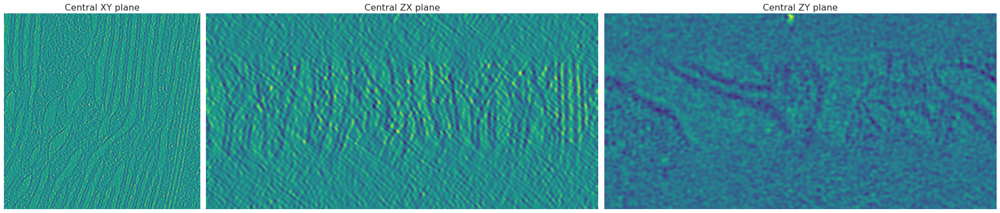

In [5]:
upper = 100
for r in range(5, upper, 20):
    masked_fourier_tomo = fourier_tomo*create_hiFreqMask(r, tomo_shape, fourier_tomo_shape)
    masked_fourier_tomo = np.fft.ifftn(np.fft.ifftshift(masked_fourier_tomo))
    masked_fourier_tomo = masked_fourier_tomo.real
    
    sphere_vol = 4/3 * np.pi * r**3
    cover_pct = 100*sphere_vol/shape_vol

    print("Percentage of the volume covered by the sphere %.02f at radius %i" %(cover_pct, r) )
    
    fig, ax = plot_centralSlices(masked_fourier_tomo, set_axis_off=True)
    plt.show()

84.16569494346916 106.04213073830729 

Percentage of the volume covered by the sphere 6.53 at radius 92


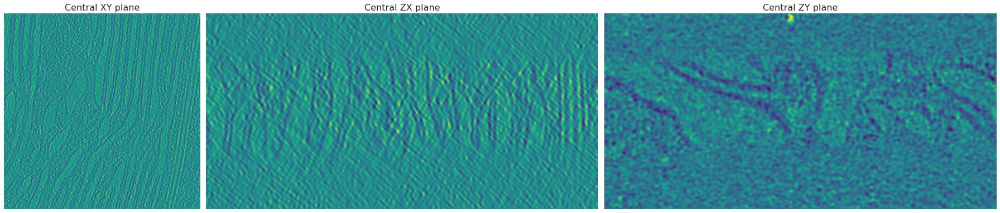

Percentage of the volume covered by the sphere 9.43 at radius 104


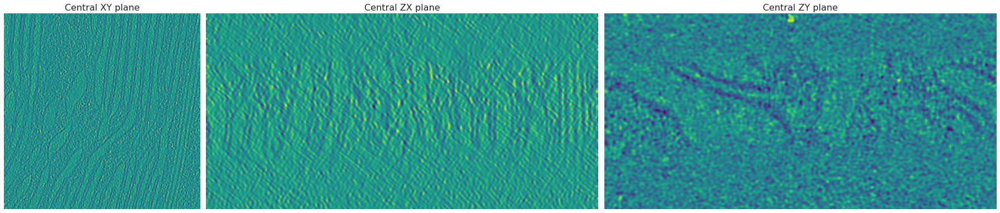

Percentage of the volume covered by the sphere 5.33 at radius 86


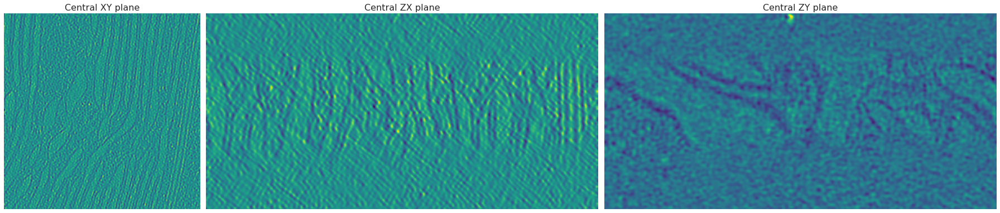

In [6]:
# choose between 5 and 10%
shape_vol = tomo_shape.prod()

low_r = (0.05 * 3/(4*np.pi) * shape_vol)**(1/3)
high_r = (0.1 * 3/(4*np.pi) * shape_vol)**(1/3)

print(low_r, high_r, '\n')

for i in range(3):
    r = np.random.uniform(low_r, high_r)
    r = int(np.round(r))
    masked_fourier_tomo = fourier_tomo*create_hiFreqMask(r, tomo_shape, fourier_tomo_shape)
    masked_fourier_tomo = np.fft.ifftn(np.fft.ifftshift(masked_fourier_tomo))
    masked_fourier_tomo = masked_fourier_tomo.real
    
    sphere_vol = 4/3 * np.pi * r**3
    cover_pct = 100*sphere_vol/shape_vol

    print("Percentage of the volume covered by the sphere %.02f at radius %i" %(cover_pct, r) )
    
    fig, ax = plot_centralSlices(masked_fourier_tomo, set_axis_off=True)
    plt.show()

# Q2: Volumetric masks plus Low pass filter

I want to get some intuition on how the volumetric mask affects the image at different masking levels

In [8]:
Vmask_pct = 0.7
volumetric_scale_factor = 8

dropoutV = torch.nn.Dropout(p=Vmask_pct)
upsample = torch.nn.Upsample(scale_factor=volumetric_scale_factor)

(232, 464, 464)
0.3008938455861249


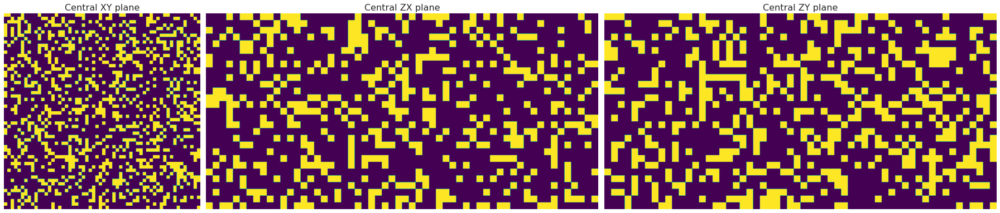

In [9]:
Vmask = create_Vmask(tomo_shape, volumetric_scale_factor)
print(Vmask.shape)
print(Vmask.sum()/tomo_shape.prod())
fig, ax = plot_centralSlices(Vmask, True)

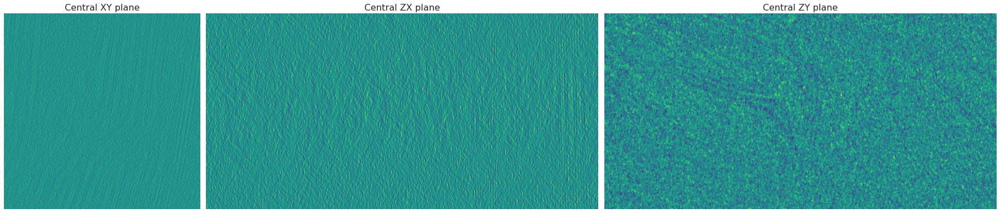

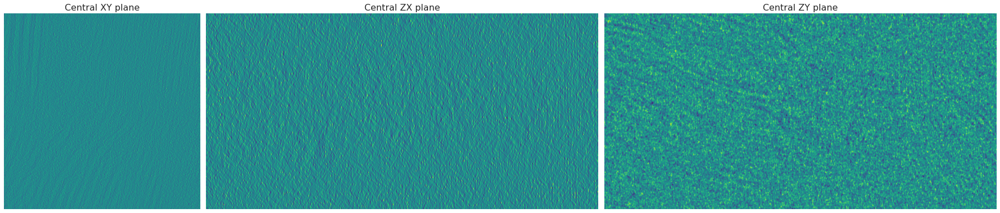

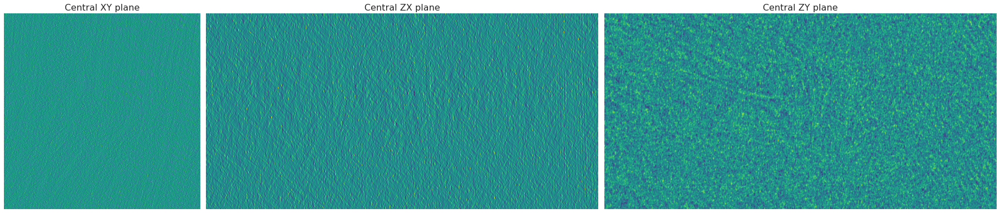

In [10]:
for i in range(3):
    Vmask = create_Vmask(tomo_shape, volumetric_scale_factor)
    masked_fourier_tomo = fourier_tomo*Vmask
    masked_fourier_tomo = np.fft.ifftn(np.fft.ifftshift(masked_fourier_tomo))
    masked_fourier_tomo = masked_fourier_tomo.real
    
    fig, ax = plot_centralSlices(masked_fourier_tomo, set_axis_off=True)
    plt.show()

84.16569494346916 106.04213073830729 

Pct of ones:  0.2985157243019394
Percentage of the volume covered by the sphere 6.11 at radius 90


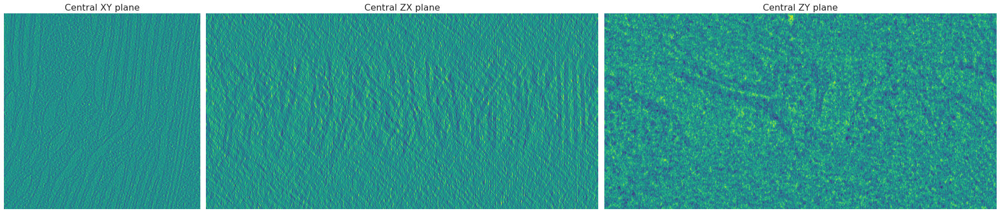

Pct of ones:  0.2997355365123621
Percentage of the volume covered by the sphere 5.33 at radius 86


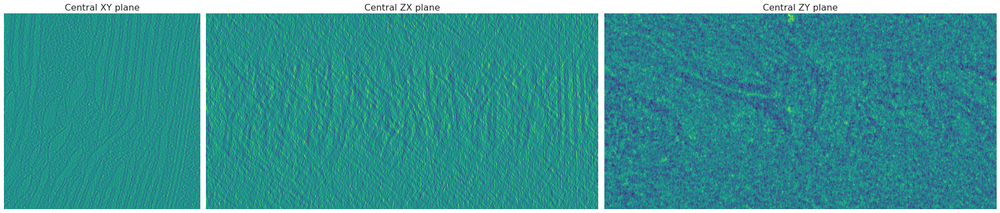

Pct of ones:  0.30148837590717126
Percentage of the volume covered by the sphere 7.19 at radius 95


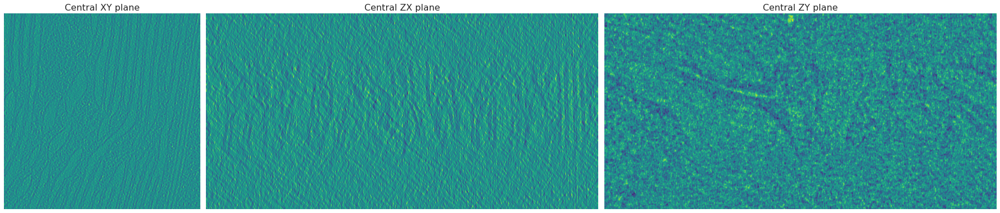

In [11]:
# choose between 5 and 10%
shape_vol = tomo_shape.prod()

low_r = (0.05 * 3/(4*np.pi) * shape_vol)**(1/3)
high_r = (0.1 * 3/(4*np.pi) * shape_vol)**(1/3)

print(low_r, high_r, '\n')

for i in range(3):
    r = np.random.uniform(low_r, high_r)
    r = int(np.round(r))
    
    lowPassMask = create_hiFreqMask(r, tomo_shape, fourier_tomo_shape)
    Vmask = create_Vmask(tomo_shape, volumetric_scale_factor)
    
    mask = lowPassMask + Vmask
    mask = np.where(mask > 1, 1, mask)
    
    nonMasked_pct = Vmask.sum()/tomo_shape.prod()
    
    print('Pct of ones: ', nonMasked_pct)
    
    masked_fourier_tomo = fourier_tomo*mask
    masked_fourier_tomo = np.fft.ifftn(np.fft.ifftshift(masked_fourier_tomo))
    masked_fourier_tomo = masked_fourier_tomo.real
    
    sphere_vol = 4/3 * np.pi * r**3
    cover_pct = 100*sphere_vol/shape_vol

    print("Percentage of the volume covered by the sphere %.02f at radius %i" %(cover_pct, r) )
    
    fig, ax = plot_centralSlices(masked_fourier_tomo, set_axis_off=True)
    plt.show()

# Q3: Phase inversion

I want to get some intuition on how the volumetric mask affects the image at different masking levels

In [42]:
def create_inversionMask(tomo_shape):
    tomo_shape = tuple(tomo_shape)
    bernoulli_Pmask = dropout(torch.ones(tomo_shape)) * (1 - dropout.p)
    bernoulli_Pmask = 2*bernoulli_Pmask - 1

    return bernoulli_Pmask.numpy()

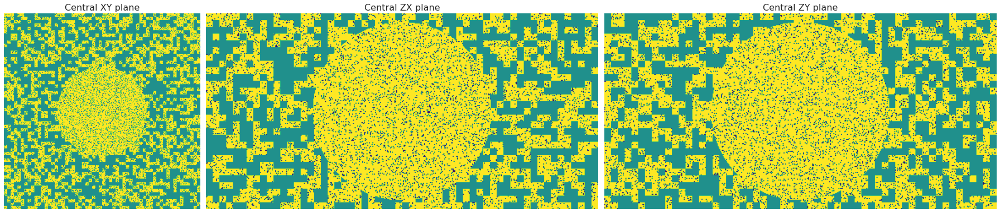

In [89]:
Vmask_pct = 0.5
volumetric_scale_factor = 8

dropoutV = torch.nn.Dropout(p=Vmask_pct)
upsample = torch.nn.Upsample(scale_factor=volumetric_scale_factor)

p = 0.1
dropout = torch.nn.Dropout(p)

invMask = create_inversionMask(tomo_shape)

Vmask = create_Vmask(tomo_shape, volumetric_scale_factor)
lowPassMask = create_hiFreqMask(tomo_shape, fourier_tomo_shape)


_mask = Vmask+lowPassMask
_mask = np.where(_mask>1, 1, _mask)
mask = _mask*invMask

# _mask = Vmask*invMask + lowPassMask
# mask = np.where(_mask>1, 1, _mask)

# _mask = (Vmask + lowPassMask)
# mask = np.where(_mask>1, 1, _mask)*invMask

fig, ax = plot_centralSlices(mask, True)

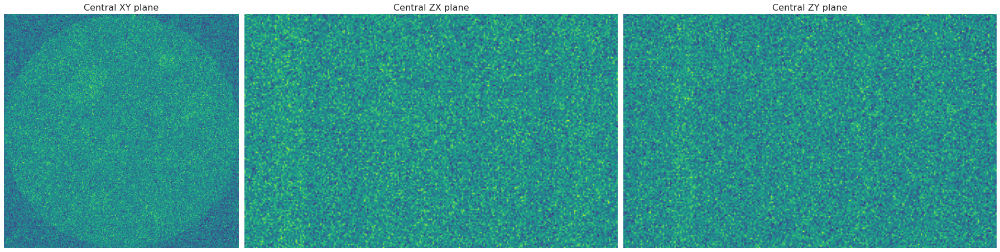

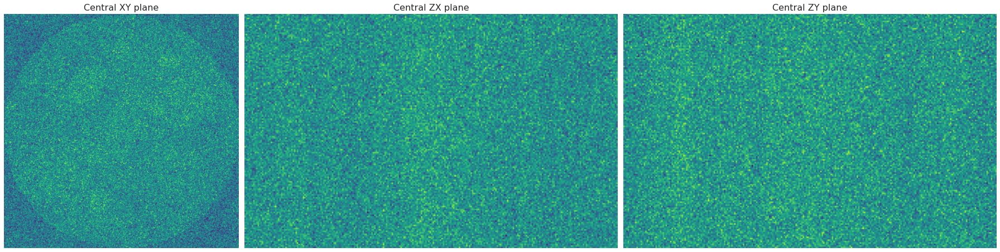

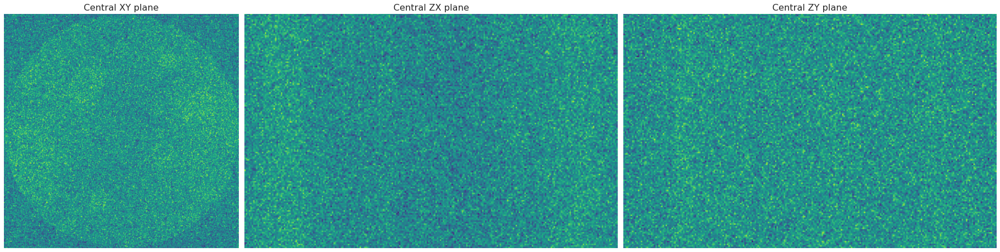

In [56]:
for i in range(3):
    
    invMask = create_inversionMask(tomo_shape)
    
    masked_fourier_tomo = fourier_tomo*invMask
    masked_fourier_tomo = np.fft.ifftn(np.fft.ifftshift(masked_fourier_tomo))
    masked_fourier_tomo = masked_fourier_tomo.real
    
    # plt.hist(masked_fourier_tomo.flatten())
    fig, ax = plot_centralSlices(masked_fourier_tomo, set_axis_off=True)
    plt.show()

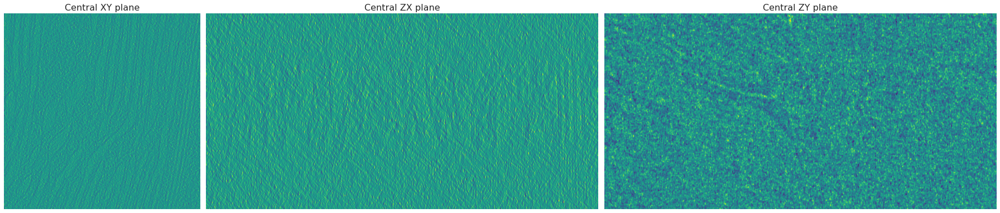

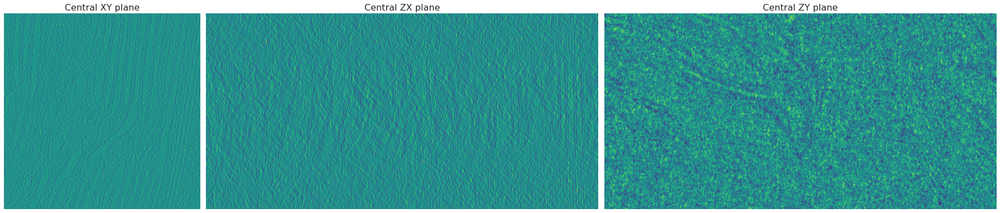

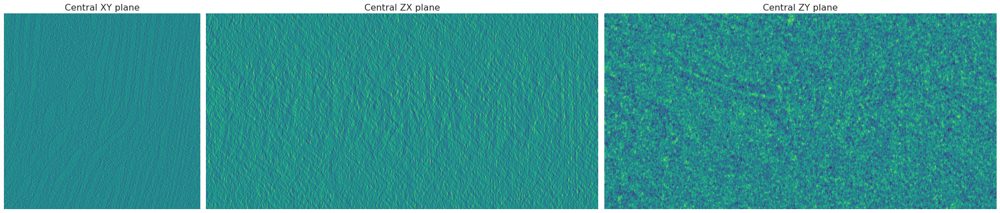

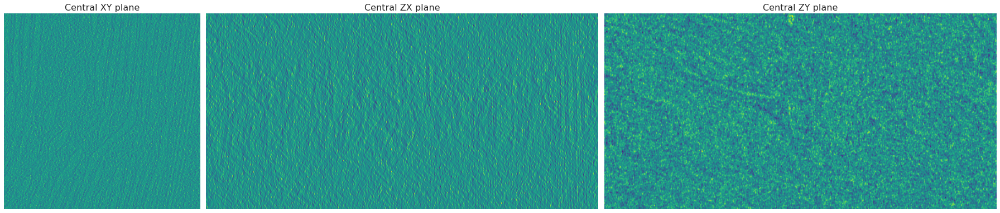

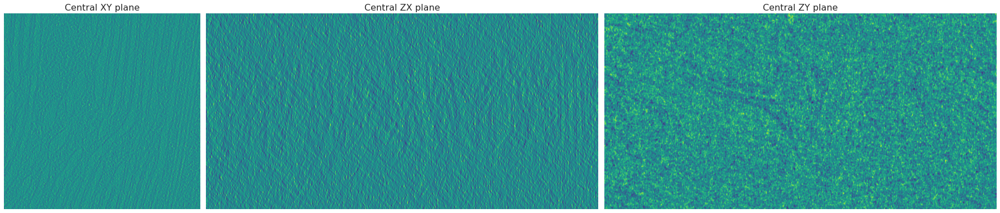

In [90]:
# combined masks
for i in range(5):
    
    invMask = create_inversionMask(tomo_shape)
    Vmask = create_Vmask(tomo_shape, volumetric_scale_factor)
    lowPassMask = create_hiFreqMask(tomo_shape, fourier_tomo_shape)

    _mask = Vmask+lowPassMask
    _mask = np.where(_mask>1, 1, _mask)
    mask = _mask*invMask
    
    # here we randomly invert phases on the Vmask,
    # then, we sum that mask to the low pass. So inside the lowFreq region
    # we have some volumes with 0,1 values
    # _mask = Vmask*invMask + lowPassMask
    # mask = np.where(_mask>1, 1, _mask)

    masked_fourier_tomo = fourier_tomo*mask
    masked_fourier_tomo = np.fft.ifftn(np.fft.ifftshift(masked_fourier_tomo))
    masked_fourier_tomo = masked_fourier_tomo.real
    
    fig, ax = plot_centralSlices(masked_fourier_tomo, set_axis_off=True)
    plt.show()

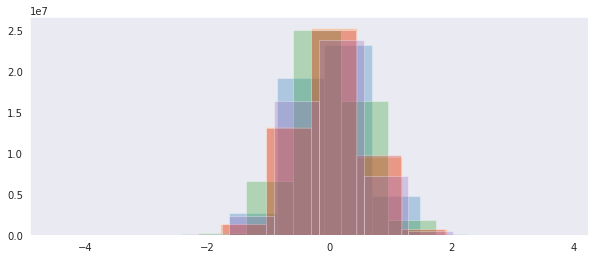

In [85]:
# combined masks
plt.figure(figsize=(10, 4))

for i in range(5):
    
    invMask = create_inversionMask(tomo_shape)
    Vmask = create_Vmask(tomo_shape, volumetric_scale_factor)
    lowPassMask = create_hiFreqMask(tomo_shape, fourier_tomo_shape)

    # _mask = Vmask+lowPassMask
    # _mask = np.where(_mask>1, 1, _mask)
    # mask = _mask*invMask
    
    # here we randomly invert phases on the Vmask,
    # then, we sum that mask to the low pass. So inside the lowFreq region
    # we have some volumes with 0,1 values
    _mask = Vmask*invMask + lowPassMask
    mask = np.where(_mask>1, 1, _mask)

    masked_fourier_tomo = fourier_tomo*mask
    masked_fourier_tomo = np.fft.ifftn(np.fft.ifftshift(masked_fourier_tomo))
    masked_fourier_tomo = masked_fourier_tomo.real
    
    plt.hist(masked_fourier_tomo.flatten(), alpha=0.3)
    
plt.show()

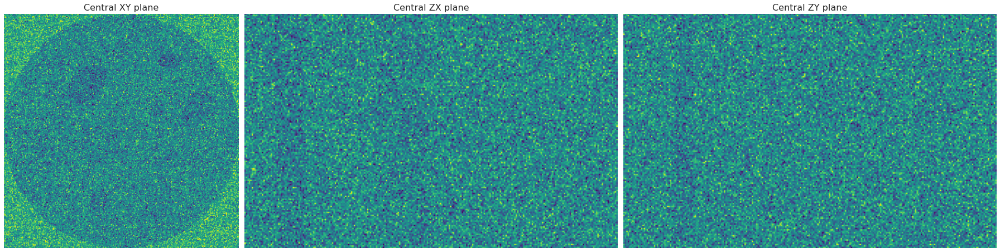

In [40]:
# what happens if we invert all phases?
# we get a contrast-inverted tomogram

p = 1
dropout = torch.nn.Dropout(p)
mask = create_inversionMask(tomo_shape)

masked_fourier_tomo = fourier_tomo*mask
masked_tomo = np.fft.ifftn(np.fft.ifftshift(masked_fourier_tomo))
masked_tomo = masked_tomo.real

fig, ax = plot_centralSlices(masked_tomo, set_axis_off=True)
plt.show()

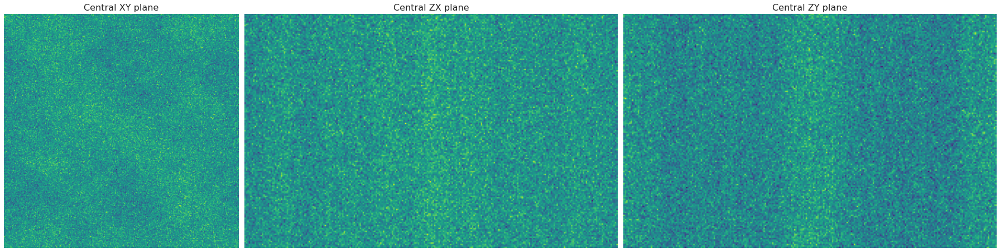

In [41]:
# what happens if we invert half of all phases?
# we get a "zero" tomogram

p = 0.5
dropout = torch.nn.Dropout(p)
mask = create_inversionMask(tomo_shape)

masked_fourier_tomo = fourier_tomo*mask
masked_tomo = np.fft.ifftn(np.fft.ifftshift(masked_fourier_tomo))
masked_tomo = masked_tomo.real

fig, ax = plot_centralSlices(masked_tomo, set_axis_off=True)
plt.show()